In [1]:
## Import Statements
import numpy as np
import matplotlib.pyplot as plt

%config InlineBackend.figure_format = 'retina'

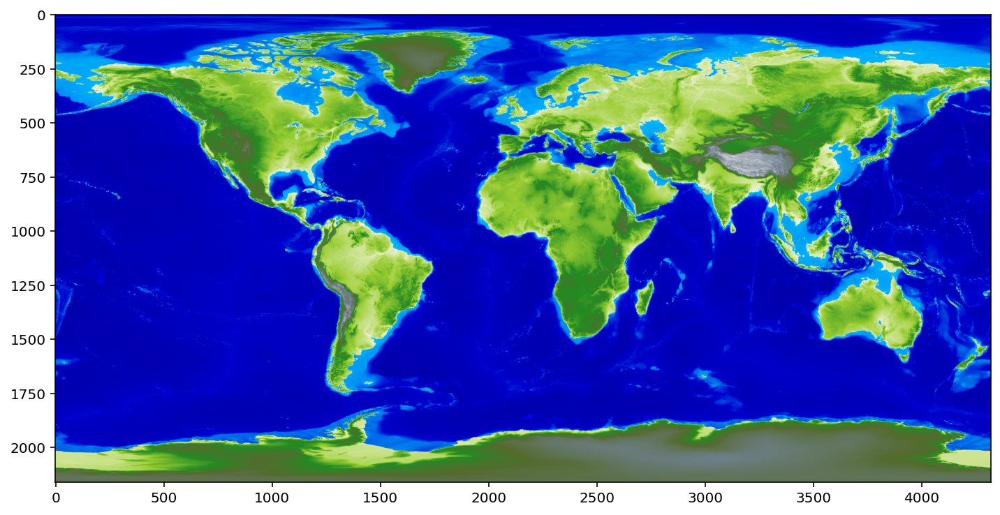

In [2]:
## Import elevation data and show an image of it
from src.map_image import *
from src.map_instance import *
from src.map_data import *

# Load the elevation data and convert it to sqrt to show better contrast
map_elevation = loadBaseMap('TBI', minutes_per_node=5, image_folder='img/01/')
data_elevation_sqrt = np.power(np.abs(map_elevation.getDataFlat() * 1.0), 0.5) * np.sign(map_elevation.getDataFlat())
data_elevation_sqrt = data_elevation_sqrt / max(data_elevation_sqrt)
map_elevation_sqrt = map_elevation.newChildInstance(
    {
        'values': 'elevation',
        'mods': 'sqrt'
    }, 
    data_elevation_sqrt
)

# Display the image & save the image.
RasterImage(map_elevation_sqrt) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='naturalish') \
    .display().save().final()


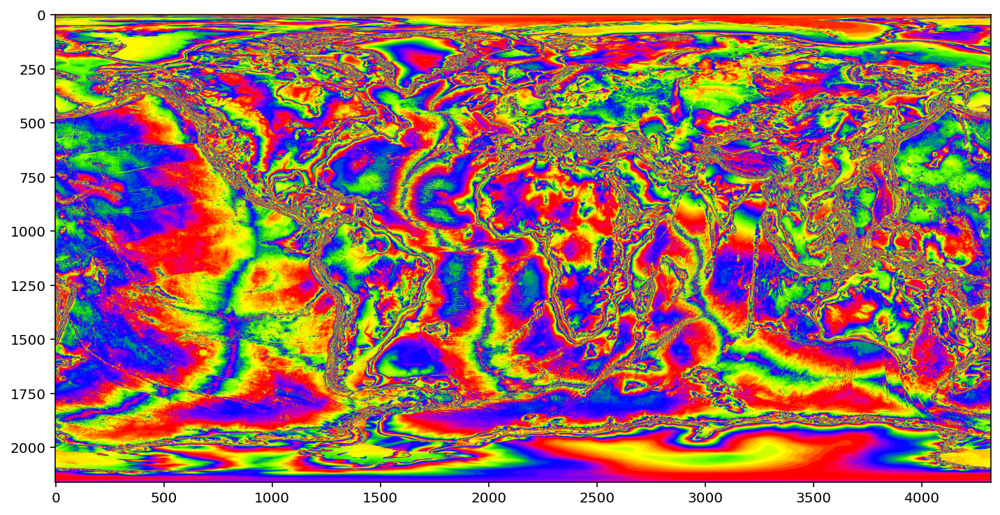

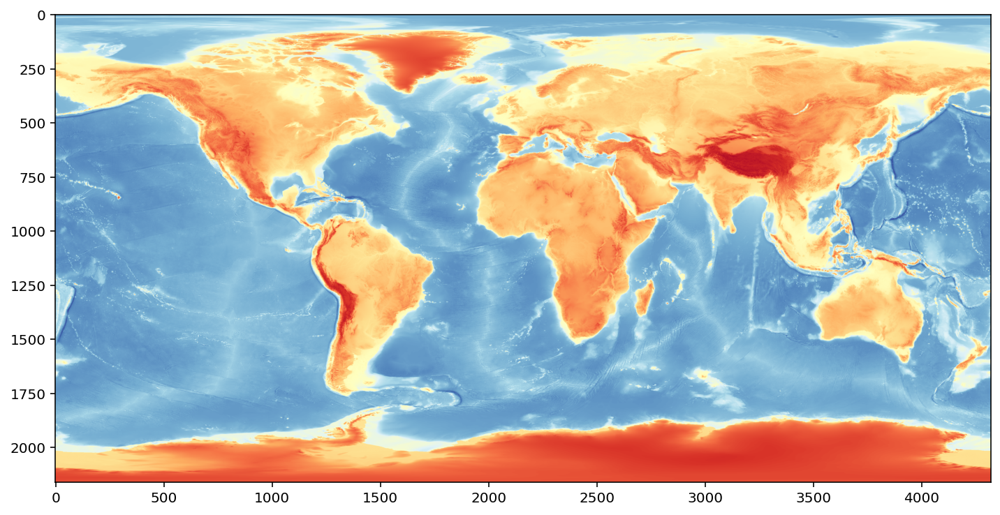

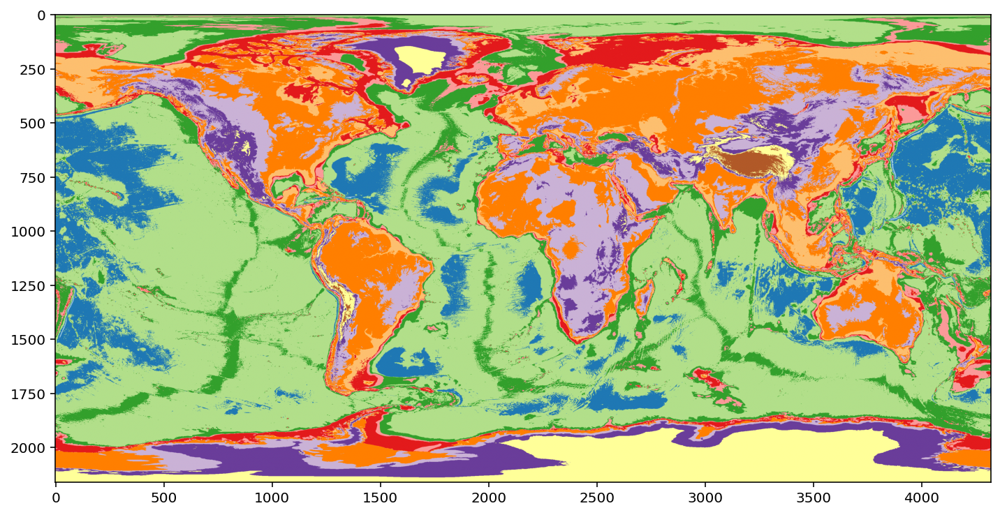

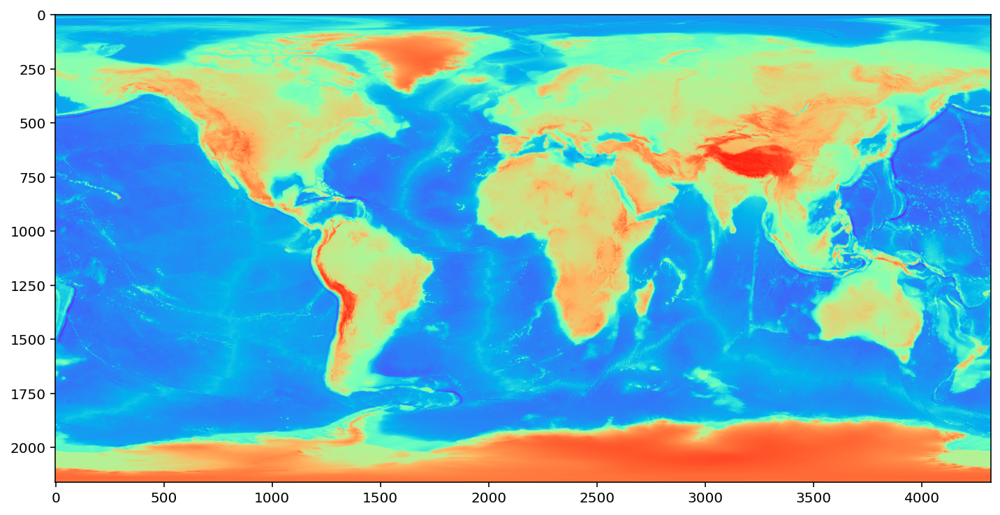

In [3]:
# More examples of the images, different colormaps
RasterImage(map_elevation_sqrt) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='prism', transforms=['norm']) \
    .display().final()
RasterImage(map_elevation_sqrt) \
    .addLayer('elevation', -map_elevation_sqrt.getDataFlat(), colormap='diverge', transforms=['norm']) \
    .display().final()
RasterImage(map_elevation_sqrt) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='qual', transforms=['norm']) \
    .display().final()
RasterImage(map_elevation_sqrt) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='rainbow', transforms=['norm']) \
    .display().final()

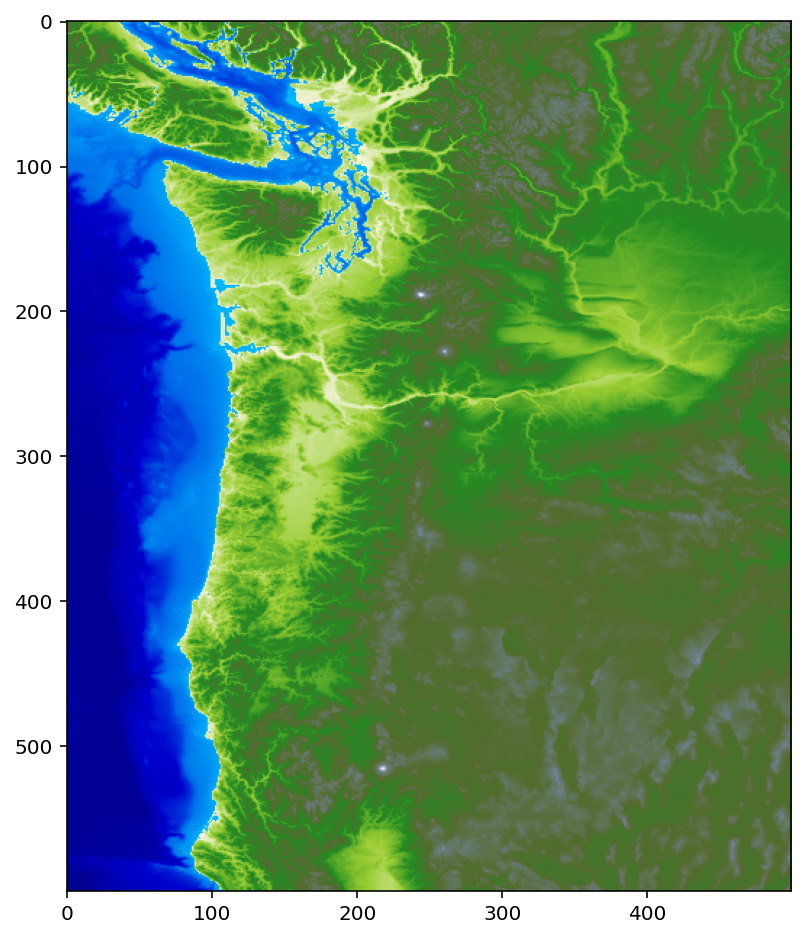

In [4]:
# Get the region data instead

# Load the region-specific elevation data and convert it to sqrt to show better contrast
map_elevation = loadRegionMap(region='cascadia', dataset='TBI', minutes_per_node=1, image_folder='img/01/')
data_elevation_sqrt = np.power(np.abs(map_elevation.getDataFlat() * 1.0), 0.5) * np.sign(map_elevation.getDataFlat())
data_elevation_sqrt = data_elevation_sqrt / max(data_elevation_sqrt)
map_elevation_sqrt = map_elevation.newChildInstance(
    {
        'values': 'elevation',
        'mods': 'sqrt'
    }, 
    data_elevation_sqrt
)

# Display the image & save the image
RasterImage(map_elevation_sqrt) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='naturalish') \
    .display().save().final()

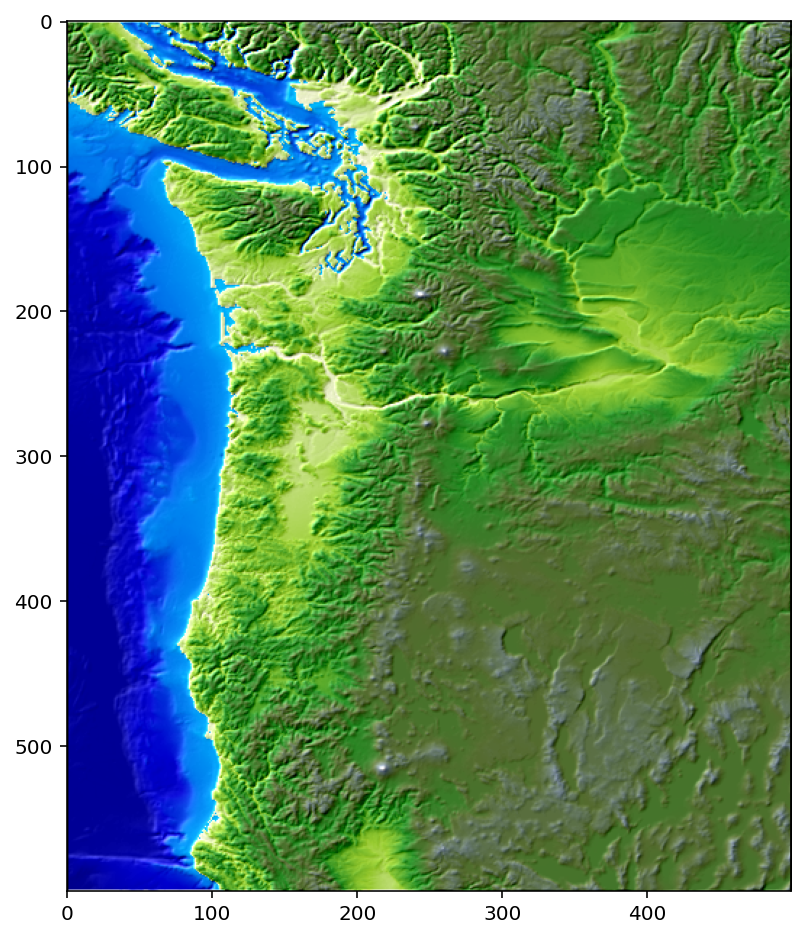

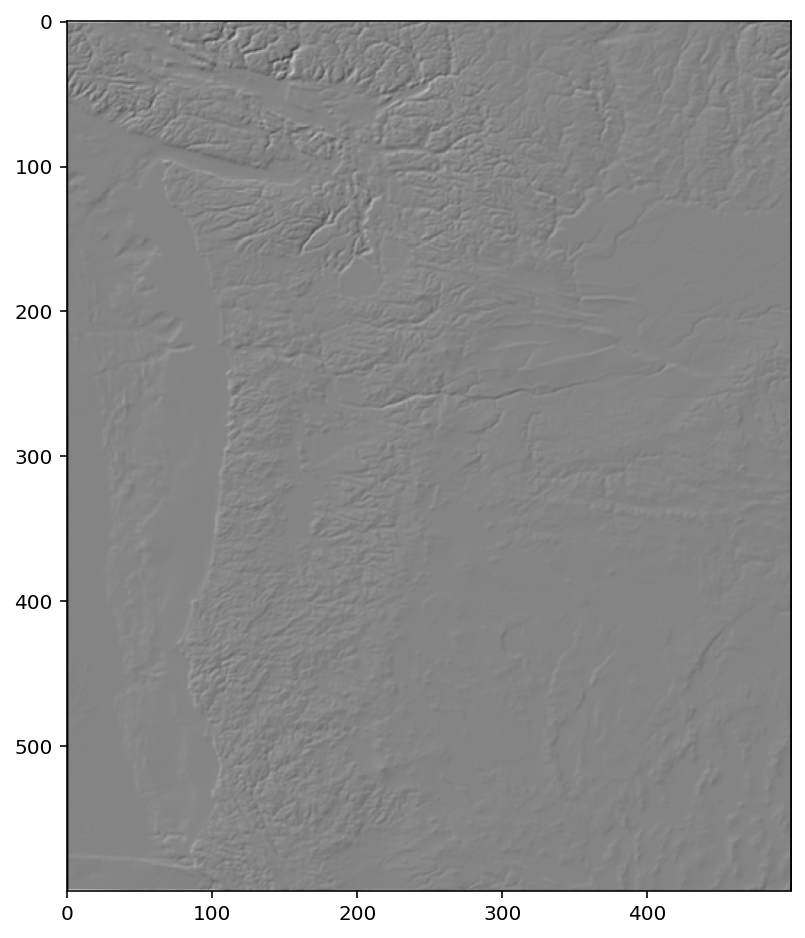

In [5]:
# Apply Hillshade to region
from src.map_transforms import *
            
map_hillshade = getHillshade(map_elevation, 1)

RasterImage(map_elevation) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='naturalish') \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=[], combine='add', opacity=1, dissolve=1) \
    .display().save().final()
RasterImage(map_hillshade) \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=['norm']) \
    .display().save().final()

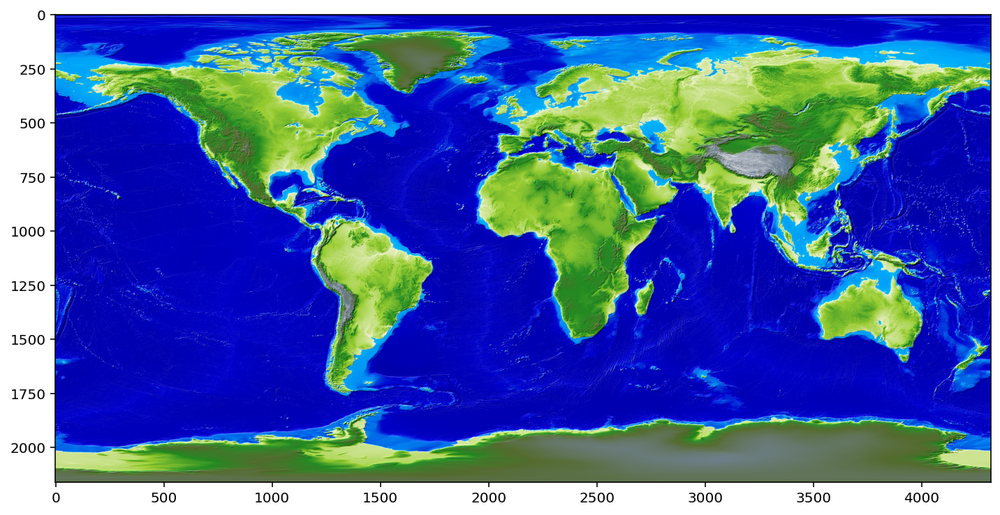

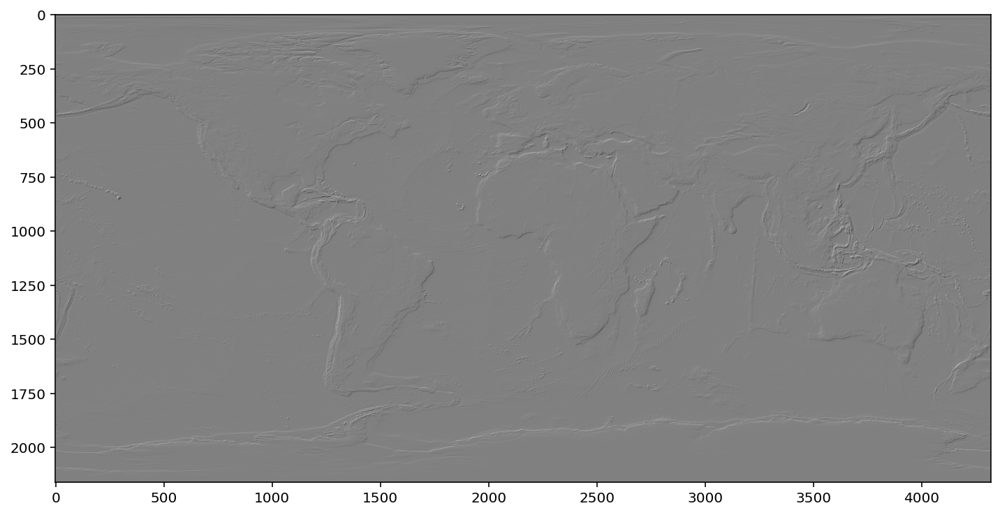

In [6]:
# Hillshade on world map
map_elevation = loadRegionMap(region='world', dataset='TBI', minutes_per_node=5, image_folder='img/01/')
data_elevation_sqrt = np.power(np.abs(map_elevation.getDataFlat() * 1.0), 0.5) * np.sign(map_elevation.getDataFlat())
data_elevation_sqrt = data_elevation_sqrt / max(data_elevation_sqrt)
map_elevation_sqrt = map_elevation.newChildInstance(
    {
        'values': 'elevation',
        'mods': 'sqrt'
    }, 
    data_elevation_sqrt
)
map_hillshade = getHillshade(map_elevation, 1)

# Display the image & save the image
RasterImage(map_elevation) \
    .addLayer('elevation', map_elevation_sqrt.getDataFlat(), colormap='naturalish') \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=[], combine='add', opacity=1, dissolve=1) \
    .display().save().final()
RasterImage(map_hillshade) \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=['norm']) \
    .display().save().final()

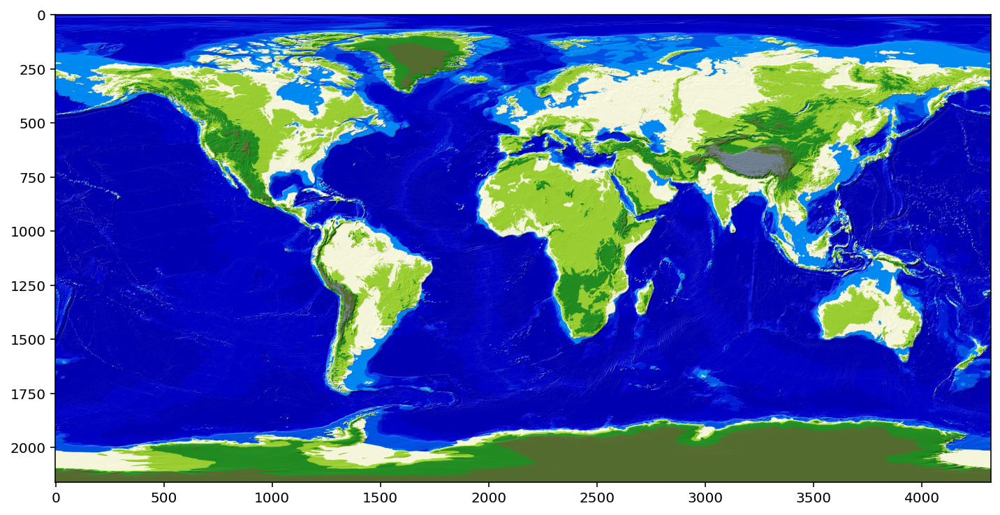

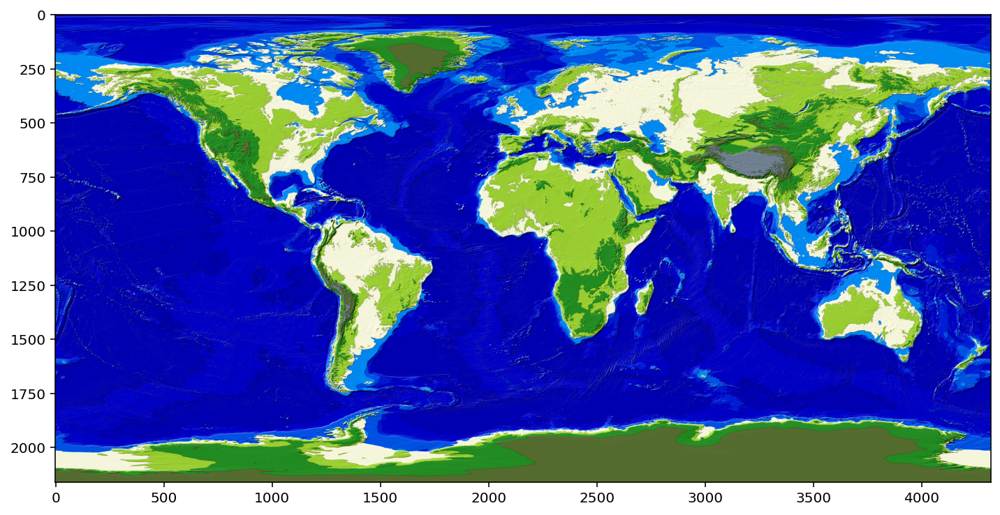

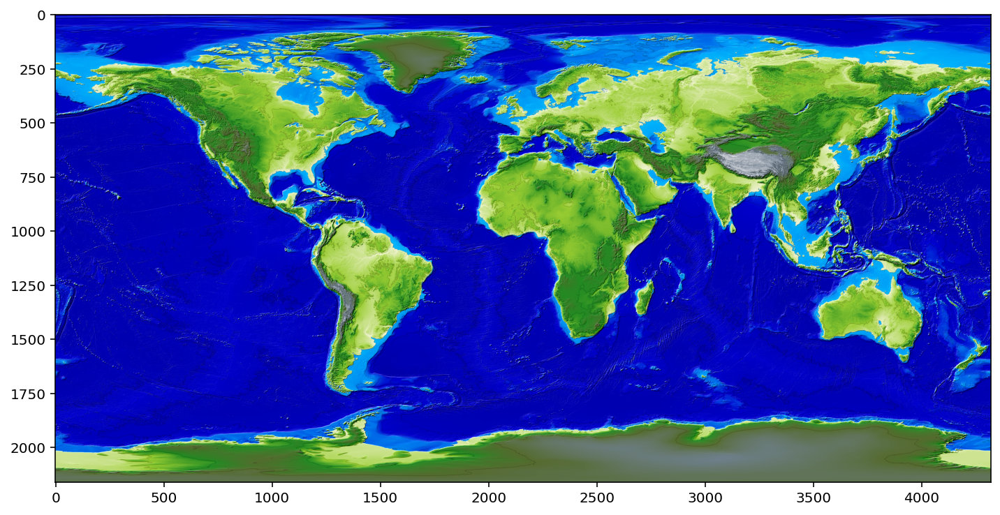

In [7]:
nodes_elevation_sqrt_segmented = np.floor(map_elevation_sqrt.getDataFlat() * 5)
map_elevation_sqrt_segmented = map_elevation_sqrt.newChildInstance({'mods': 'segmented'}, nodes_elevation_sqrt_segmented)
map_elevation_border = getBorder(map_elevation_sqrt_segmented, 1)

# Display the image & save the image
RasterImage(map_elevation) \
    .addLayer('elevation_binned', nodes_elevation_sqrt_segmented, colormap='naturalish') \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=[], combine='add', opacity=1, dissolve=1) \
    .display().final()
RasterImage(map_elevation) \
    .addLayer('elevation_binned', nodes_elevation_sqrt_segmented, colormap='naturalish') \
    .addLayer('elevation_border', 0.8, nodes_selected=map_elevation_border.getDataFlat(), combine='multiply') \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=[], combine='add', opacity=1, dissolve=1) \
    .display().save().final()
RasterImage(map_elevation) \
    .addLayer('elevation_bins', map_elevation_sqrt.getDataFlat(), colormap='naturalish') \
    .addLayer('elevation_border', 0.8, nodes_selected=map_elevation_border.getDataFlat(), combine='multiply') \
    .addLayer('hillshade', map_hillshade.getDataFlat(), transforms=[], combine='add', opacity=1, dissolve=1) \
    .display().final()

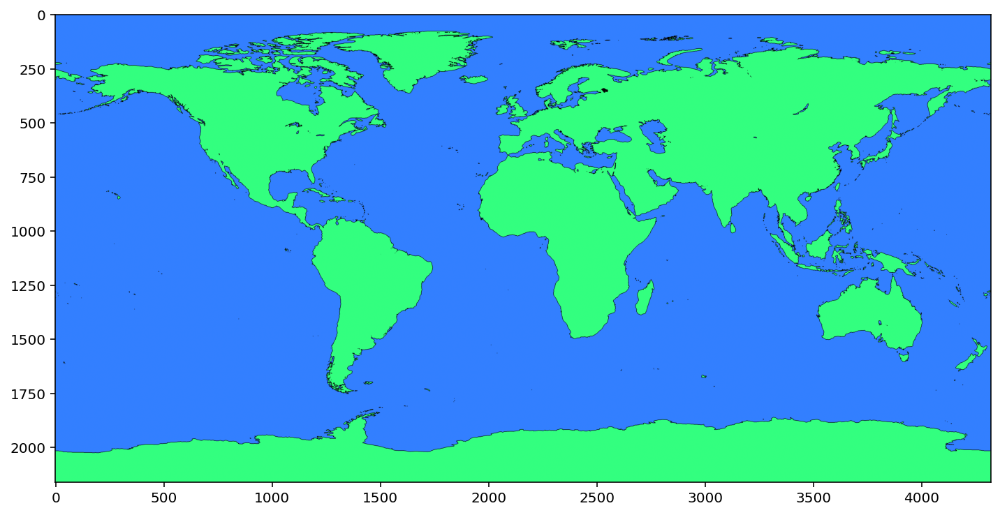

In [8]:
map_landsea = map_elevation.newChildInstance(
    {'values': 'landmask'},
    map_elevation.getDataFlat() < 0,
)
map_landsea_border = getBorder(map_landsea, 1)

# Make images
RasterImage(map_landsea_border) \
    .addLayer('land', [0.2,1.0,0.5], nodes_selected=map_elevation.getDataFlat() > 0, combine='set') \
    .addLayer('sea',  [0.2,0.5,1.0], nodes_selected=map_elevation.getDataFlat() < 0, combine='set') \
    .addLayer('landsea_border', [0,0,0], nodes_selected=map_landsea_border.getDataFlat(), transforms=['norm'], combine='set') \
    .display().save().final()